# Расчет числа Лемтюгова для игроков Континентальной хоккейной лиги

**Цель проекта:**

Создать аналог числа Эрдёша — Бэйкона для игроков Континентальной хоккейной лиги, позволяющего измерить "близость" хоккеистов к Николаю Лемтюгову через команды, в которых они играли.

**Описание данных**

khl.csv:
* player_link - ссылка на страницу игрока
* player - имя игрока
* team - команда
* start_date - начало игры за команду
* end_date - конец игры за команду


khl_stats.csv:
* player_link - ссылка на страницу игрока
* player - имя игрока
* position - игровое амплуа, возможные значения:
  * *forward* - форвард
  * *defense* - защитник
  * *goaltender* - голкипер
* born - дата рождения
* age - возраст
* country - страна
* hight - рост в сантиметрах
* weight - вес в килограммах
* shoot - хват клюшки
* gp - количество проведенных игр
* goals - заброшенные шайбы
* assists - голевые передачи
* pts - очки
* '+/-' - показатель плюс/минус
* '+' - показатель плюс
* '-' - показатель минус
* pim - штрафное время в минутах
* esg - шайбы, заброшенные в равных составах
* ppg - шайбы, заброшенные в большинстве
* shg - шайбы, заброшенные в меньшинстве
* otg - шайбы, заброшенные в овертайме
* gwg - победные шайбы
* sds - решающие буллиты
* sog - броски по воротам
* %sog - процент реализованных бросков
* s/g - среднее количество бросков по воротам за игру
* fo - вбрасывания
* fow - выигранные вбрасывания
* %fo - процент выигранных вбрасываний
* toi/g - среднее время на площадке за игру
* sft/g - среднее количество смен за игру
* tie/g - среднее время на площадке при игре в равных составах за игру
* sfte/g - среднее количество смен при игре в равных составах за игру
* tipp/g - среднее время на площадке при игре в большинстве за игру
* sftpp/g - среднее количество смен при игре в большинстве за игру
* tish/g - среднее время на площадке при игре в меньшинстве за игру
* sftsh/g - среднее количество смен при игре в меньшинстве за игру
* hits - силовые приемы
* bls - блокированные броски
* foa - фолы против
* tka - отборы шайбы
* wins - выигрыши
* losses - проигрыши
* sop - игры с буллитными сериями
* ga - пропущено шайб
* sv - отраженные броски
* %sv - процент отраженных бросков
* gaa - коэффициент надежности
* so - сухие игры
* toi - время на площадке


**План работы**<a id='7'></a>
1. [Ознакомление с данными](#1) (изучение общей информации о датасетах)
* количество строк и столбцов
* количество и доля пропусков

2. [Предобработка данных](#2)
* изменение типов данных
* поиск явных и удаление дубликатов
* подготовка данных для расчета числа Лемтюгова

3. [Расчет числа Лемтюгова](#3)
* создание графа игроков и их одноклубников
* кратчайшего пути между двумя вершинами на графе для расчета числа Лемтюгова

4. [Проверка гипотез](#4)
* проверка нескольких гипотез
* кластеризация игроков

5. [Визуализация](#5)
* создание визуализаций, отражающих связи между игроками

6. [Общий вывод](#6)
* подведение итогов исследования

<a id='1'></a>
## [Ознакомление с данными](#7)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
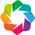

In [1]:
import pandas as pd
import numpy as np
from datetime import datetime
from queue import Queue
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly
from tqdm import tqdm
import holoviews as hv #version 1.15.0
import bokeh #version 2.4.3
from holoviews import opts, dim
import holoviews.plotting.bokeh
from bokeh.plotting import show, output_file
from holoviews.element.graphs import layout_nodes
hv.extension('bokeh')
from holoviews.operation.datashader import datashade, bundle_graph
import networkx as nx
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy import stats as st
import itertools

In [2]:
#уберем ограничения на количество строк и столбцов в таблицах
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

Прочитаем файлы об игроках и их переходах в другие клубы.

In [3]:
url='https://drive.google.com/file/d/1x-Y3z6JjJnE1ZwiEIIQKCg50vNbi1_dR/view?usp=sharing'
url='https://drive.google.com/uc?id=' + url.split('/')[-2]
khl = pd.read_csv(url)

url='https://drive.google.com/file/d/1_ht4rHboG0P_BJtDumkMi0VXrFqhOL17/view?usp=sharing'
url='https://drive.google.com/uc?id=' + url.split('/')[-2]
khl_stats = pd.read_csv(url)

Определим функцию для получения основной информации о датафрейме. Функция выведет первые 5 строк датафрейма, информацию о датафрейме с помощью метода df.info(), а также количество пропущенных значений в датафрейме и их долю.

In [4]:
def observe(df):
    display(df.head())
    print('')
    print(df.info())
    print('')
    display(
        pd.DataFrame(
            np.array([df.isna().sum(), df.isna().mean() * 100]).T,
            columns = ['кол-во пропусков', 'доля пропусков'],
            index=df.columns
        ).style.background_gradient('coolwarm').format({'кол-во пропусков' : '{:.0f}', 'доля пропусков' : '{:.2f}'})
    )

Выведем основную информацию о датасетах.

In [5]:
dataframes = {'khl' : khl, 'khl_stats' : khl_stats}
for i in dataframes:
    print('Основная информация о датафрейме', i)
    observe(dataframes[i])

Основная информация о датафрейме khl


,player_link,player,team,start_date,end_date
0,https://en.khl.ru/players/16785/?idplayer=1678...,Juhamatti Aaltonen,Jokerit,4 Sep 2014,2 Mar 2016
1,https://en.khl.ru/players/16785/?idplayer=1678...,Juhamatti Aaltonen,Metallurg Mg,9 Sep 2010,22 Mar 2012
2,https://en.khl.ru/players/17585/?idplayer=1758...,Miro Aaltonen,Vityaz,2 Sep 2021,11 Jan 2022
3,https://en.khl.ru/players/17585/?idplayer=1758...,Miro Aaltonen,SKA,17 Dec 2019,27 Feb 2021
4,https://en.khl.ru/players/17585/?idplayer=1758...,Miro Aaltonen,Vityaz,27 Aug 2016,9 Dec 2019



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8179 entries, 0 to 8178
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   player_link  8179 non-null   object
 1   player       8179 non-null   object
 2   team         8179 non-null   object
 3   start_date   8179 non-null   object
 4   end_date     8179 non-null   object
dtypes: object(5)
memory usage: 319.6+ KB
None



,кол-во пропусков,доля пропусков
player_link,0,0.00
player,0,0.00
team,0,0.00
start_date,0,0.00
end_date,0,0.00


Основная информация о датафрейме khl_stats


,player_link,player,position,born,age,country,hight,weight,shoot,gp,goals,assists,pts,+/-,+,-,pim,esg,ppg,shg,otg,gwg,sds,sog,%sog,s/g,fo,fow,%fo,toi/g,sft/g,tie/g,sfte/g,tipp/g,sftpp/g,tish/g,sftsh/g,hits,bls,foa,tka,wins,losses,sop,ga,sv,%sv,gaa,so,toi
0,https://en.khl.ru/players/16785/?idplayer=1678...,Juhamatti Aaltonen,forward,1985-06-04,38,Finland,184,89,right,245,78.0,73.0,151.0,25.0,136.0,111.0,130.0,60.0,17.0,1.0,1.0,14.0,0.0,550.0,14.2,2.2,33.0,13.0,39.4,15:34,19.8,12:30,18.00,2:44,3.62,0:21,0.74,31.0,17.0,22.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,https://en.khl.ru/players/17585/?idplayer=1758...,Miro Aaltonen,forward,1993-06-07,30,Finland,177,84,left,256,69.0,106.0,175.0,3.0,152.0,149.0,99.0,42.0,25.0,2.0,1.0,12.0,1.0,618.0,11.2,2.4,2602.0,1116.0,42.9,17:36,22.8,13:38,20.59,3:16,3.79,0:43,1.50,182.0,116.0,60.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,https://en.khl.ru/players/13041/?idplayer=1304...,Ruslan Abdrakhmanov,forward,1984-12-25,38,Russia,178,77,left,10,0.0,0.0,0.0,0.0,2.0,2.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,0.0,0.8,1.0,1.0,100.0,10:07,12.6,9:14,11.70,0:48,1.80,0:05,0.30,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,https://en.khl.ru/players/38736/?idplayer=3873...,Jindrich Abdul,forward,1996-02-01,27,Czechia,185,85,left,12,3.0,2.0,5.0,0.0,6.0,6.0,2.0,3.0,0.0,0.0,0.0,1.0,0.0,17.0,17.6,1.4,0.0,0.0,NaN,12:51,17.7,10:21,15.75,1:34,2.33,0:57,1.75,6.0,3.0,7.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,https://en.khl.ru/players/24998/?idplayer=2499...,Ilnur Abdulkhakov,goaltender,1999-01-15,24,Russia,187,84,left,0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,NaN



<class 'pandas.core.frame.DataFrame'>
Int64Index: 3717 entries, 0 to 3716
Data columns (total 50 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   player_link  3717 non-null   object 
 1   player       3717 non-null   object 
 2   position     3717 non-null   object 
 3   born         3717 non-null   object 
 4   age          3717 non-null   int64  
 5   country      3717 non-null   object 
 6   hight        3717 non-null   int64  
 7   weight       3717 non-null   int64  
 8   shoot        3717 non-null   object 
 9   gp           3717 non-null   int64  
 10  goals        3716 non-null   float64
 11  assists      3716 non-null   float64
 12  pts          3226 non-null   float64
 13  +/-          3226 non-null   float64
 14  +            3226 non-null   float64
 15  -            3226 non-null   float64
 16  pim          3716 non-null   float64
 17  esg          3226 non-null   float64
 18  ppg          3226 non-null   float64
 19  shg  

,кол-во пропусков,доля пропусков
player_link,0,0.00
player,0,0.00
position,0,0.00
born,0,0.00
age,0,0.00
country,0,0.00
hight,0,0.00
weight,0,0.00
shoot,0,0.00
gp,0,0.00


В датафрейме khl 8179 строк и 5 столбцов, khl_stats - 3717 строк и 50 столбцов. Имеется достаточное количетсво данных для проведения исследования. В датафрейме khl пропущеные значения отстутсвут, нужно привести столбцы с датами к соответствующему формату. В датафрейме khl_stats есть пропущеные значения, большинство которых может быть связано с разными параметрами статистики полевых игроков и вратарей.

<a id='2'></a>
## [Предобработка данных](#7)

Изменим тип столбцов 'start_date', 'end_date' в датафрейме khl на datetime.

In [6]:
khl['start_date'] = pd.to_datetime(khl['start_date'], dayfirst=True)
khl['end_date'] = pd.to_datetime(khl['end_date'], dayfirst=True)

Переименуем столбцы 'start_date' и 'end_date' на 'start_play' и 'end_play' соответственно (потому, что мне так удобнее).

In [7]:
khl = khl.rename(columns={'start_date' : 'start_play', 'end_date' : 'end_play'})

Проверим датафреймы на наличие явных дубликатов.

In [8]:
for i in dataframes:
    print('Количество явных дубликатов в датафрейме {0}: {1}, доля явных дубликатов: {2:.2f}%'\
          .format(i, dataframes[i].duplicated().sum(), dataframes[i].duplicated().sum() / len(dataframes[i]) * 100))

Количество явных дубликатов в датафрейме khl: 0, доля явных дубликатов: 0.00%
Количество явных дубликатов в датафрейме khl_stats: 0, доля явных дубликатов: 0.00%


Явные дубликаты в датафреймах отсутствуют.

Для больлшего удобства выделим из столбца `player_link` id игроков в отдельный столбец в датафреймах khl и khl_stats.

In [9]:
khl.insert(0, 'id', khl['player_link'].str.split('/', expand=True)[4])
khl_stats.insert(0, 'id', khl_stats['player_link'].str.split('/', expand=True)[4])

Для того чтобы получить список одноклубников для каждого игрока объединим датафрейм сам с собой по сезону и команде. Также исключим записи где игрок я вляется одноклубником самому себе и уберем "одноклубников" которые были в команде когда игрок в ней не играл.

In [10]:
khl_teammates = khl.merge(khl, on='team', suffixes=('', '_y'))
khl_teammates = khl_teammates[khl_teammates['id'] != khl_teammates['id_y']]
khl_teammates = khl_teammates[~((khl_teammates['start_play_y'] < khl_teammates['start_play'])\
                                & (khl_teammates['end_play_y'] < khl_teammates['start_play']))\
                             & ~((khl_teammates['start_play_y'] > khl_teammates['end_play'])\
                                 & (khl_teammates['end_play_y'] > khl_teammates['end_play']))]

На этапе предобработки данных мы изменили тип столбцов 'start_date', 'end_date' в датафрейме khl на datetime, убедились в отсутствии явных дубликатов в датафреймах, подготовили данные для расчета числа Лемтюгова.

<a id='3'></a>
## [Расчет числа Лемтюгова](#7)

Создадим словарь (он же граф) из id игроков и их одноклубников для расчета числа Лемтюгова.

In [11]:
team_dict = dict(khl_teammates.groupby('id').agg(timmates=('id_y', 'unique'))['timmates'])

In [12]:
#конвертируем значения из массива в список
for k, v in team_dict.items():
    team_dict[k] = v.tolist()

In [13]:
#функция для поиска кратчайшего пути между двумя вершинами на графе
def calculate_distance(input_graph, source):
    Q = Queue()
    distance_dict = {k: 999999999 for k in input_graph.keys()}
    visited_vertices = list()
    Q.put(source)
    visited_vertices.append(source)
    while not Q.empty():
        vertex = Q.get()
        if vertex == source:
            distance_dict[vertex] = 0
        for u in input_graph[vertex]:
            if u not in visited_vertices:
                if distance_dict[u] > distance_dict[vertex] + 1:
                    distance_dict[u] = distance_dict[vertex] + 1
                Q.put(u)
                visited_vertices.append(u)
    return distance_dict

Рассчитаем число Лемтюгова для каждого игрока КХЛ - кратчайшее расстояние между вершинами на графе (игроками), отправной точнкой на графе будет Николай Лемтюгов.

In [14]:
distances = calculate_distance(team_dict, khl.query('player == "Nikolai Lemtyugov"').id.unique()[0])

In [15]:
#преобразуем получившийся словарь со значениями числа Лемтюгова в датафрейм.
lemtyugov_number = pd.DataFrame.from_dict(distances, orient='index').reset_index()\
.rename(columns={'index': 'id', 0: 'number'})
#добавим в датафрейм столбец с именами игроков и отсортируем его по убыванию числа Лемтюгова
lemtyugov_number = lemtyugov_number.merge(khl[['id', 'player']].drop_duplicates()\
                                          , on='id', how='left')
lemtyugov_number = lemtyugov_number[['id', 'player', 'number']]\
.sort_values(by=['number', 'player'], ascending=[False, True]).reset_index(drop=True)

Выведем первые 10 значений числа Лемтюгова отсторитрованных по убыванию.

In [16]:
lemtyugov_number.head(10)

,id,player,number
0,35044,Adam Cracknell,3
1,40832,Aldiyar Nurlan,3
2,39895,Alex Lintuniemi,3
3,39693,Alexander Perevalov,3
4,15274,Alexander Usenko,3
5,21604,Alexei Badun,3
6,4715,Alexei Chupin,3
7,19108,Alexei Shantyka,3
8,24580,Alexei Toropchenko,3
9,34727,Andrew Miller,3


На этапе расчета числа Лемтюгова мы создали граф из id игроков и их одноклубников, а затем с помощью функции для поиска кратчайшего пути между двумя вершинами на графе рассчитали число Лемтюгова для каждого игрока КХЛ. Данное число варьируется от 0 до 3.

<a id='4'></a>
## [Проверка гипотез](#7)

### Гипотеза № 1: Николай Лемтюгов – самый популярный хоккеист в лиге, то есть обладающий самым большим количеством одноклубников.

Посмотрим на каком месте по количеству одноклубников находится Николай Лемтюгов. Поскольку у многих игроков одинаковое количество одноклубников созданим столбец с местом/рангом игрока по количеству одноклубников.

In [17]:
timmates = khl_teammates.groupby(['id', 'player']).agg(timmates_count=('id_y', 'nunique'))\
.sort_values(by=['timmates_count', 'player'], ascending=[False, True]).reset_index()
timmates['rank'] = timmates['timmates_count'].rank(ascending=False, method='dense').astype('int')

In [18]:
timmates.query('player == "Nikolai Lemtyugov"')

,id,player,timmates_count,rank
71,13705,Nikolai Lemtyugov,357,50


Лемтюгов находится всего лишь на 50 месте с 357 одноклубниками.

Выведем топ-20 хоккеистов по количеству одноклубников.

In [19]:
pd.concat([timmates.query('rank <= 20'), timmates.query('player == "Nikolai Lemtyugov"')])\
.style.apply(lambda x: ['background: lightgreen' if x.player in ['Nikolai Lemtyugov'] else '' for i in x], axis=1)

,id,player,timmates_count,rank
0,4351,Evgeny Lapenkov,475,1
1,548,Gennady Stolyarov,467,2
2,14299,Denis Kazionov,464,3
3,14815,Vladimir Galuzin,454,4
4,494,Denis Parshin,446,5
5,14674,Alexander Lazushin,445,6
6,10546,Yakov Rylov,443,7
7,14867,Mikhail Grigoryev,437,8
8,13871,Ilya Proskuryakov,436,9
9,15846,Nikita Tochitsky,430,10


Больше всего одноклубников у Евгения Лапенкова - 475.

Гипотезу о том, что Николай Лемтюгов – самый популярный хоккеист в лиге, то есть обладающий самым большим количеством одноклубников, отвергаем.

### Гипотеза № 2: игроки с низким значением числа Лемтюгова играли в среднем в большем количестве команд, чем игроки, у которых это значение больше.

Расчитаем среднее количество команд для каждого числа Лемтюгова.

In [20]:
lemtyugov_number.query('player != "Nikolai Lemtyugov"').merge(khl[['id', 'team', 'start_play', 'end_play']]\
                       .groupby('id').agg(team_count=('team', 'count')), on='id', how='left')\
                       .groupby('number').agg(avg_teams=('team_count', 'mean')).round(2).reset_index()

,number,avg_teams
0,1,4.29
1,2,2.00
2,3,1.03


Из таблицы видно, что игроки с низким значением числа Лемтюгова дейтвительно в реднем играли в большем количестве команд, чем игроки, у которых число Лемтюгова больше. Гипотеза подтверждена.

Дополнительно проверим гипотезу статистическими методами.

Подготовим таблицу с числом Лемтюгова и количеством команд для каждого игрока.

In [21]:
teams = lemtyugov_number.query('player != "Nikolai Lemtyugov"')\
.merge(khl[['id', 'team', 'start_play', 'end_play']]).groupby(['id', 'number']).agg(count=('team', 'count')).reset_index()
teams.head()

,id,number,count
0,1,2,2
1,10162,2,6
2,10176,2,4
3,10427,2,1
4,10541,1,2


Для значений числа Лемтюгова от 1 до 3 проверим попарно нашу гипотезу о том, что игроки с низким значением числа Лемтюгова играли в среднем в большем количестве команд, чем игроки, у которых это значение больше на уровне значимости aplha = 0.05, используюя метод Бонферрони.

In [22]:
alpha = 0.05 #задаем уровень значимости
bonferroni_alpha = alpha / 3 #рассчитываем поправку Бонферрони

Проверим гипотезу для значений числа Лемтюгова 1 и 2.<br>
**Нулевая гипотеза H0:** игроки с числом Лемтюгова равным 1 и 2 играли в среднем в таком же количестве команд.<br>
**Альтернативная гипотеза H1:** игроки с числом Лемтюгова равным 1 играли в среднем в большем количестве команд, чем игроки с числом Лемтюгова равным 2.<br>
Уровень значимости aplha = 0.05.

In [23]:
result = st.ttest_ind(teams[teams['number'] == 1]['count'], teams[teams['number'] == 2]['count'], alternative='greater')
print('p-значение:', result.pvalue)
if result.pvalue < bonferroni_alpha:
    print('По имеющимся данным на уровне значимости {0:.2f}% (с учетом поправки Бонферрони)'\
                  .format(bonferroni_alpha * 100),
            'есть основания отвергнуть нулевую гипотезу об \nотсутствии различий в среднем количестве команд у игроков с '
            'числом Лемтюгова равным 1 и 2 в пользу альтернативной гипотезы о\nбольшем количестве команд у игроков с числом '
            'Лемтюгова равным 1, чем у игроков с числом Лемтюгова равным 2.')
else:
    print('По имеющимся данным на уровне значимости {0:.2f}% (с учетом поправки Бонферрони)'\
                  .format(bonferroni_alpha * 100),
            'нет оснований отвергнуть нулевую гипотезу об \nотсутствии различий в среднем количестве команд у игроков с '
            'числом Лемтюгова равным 1 и 2 в пользу альтернативной гипотезы о\nбольшем количестве команд у игроков с числом '
            'Лемтюгова равным 1, чем у игроков с числом Лемтюгова равным 2.')

p-значение: 2.296891381004228e-108
По имеющимся данным на уровне значимости 1.67% (с учетом поправки Бонферрони) есть основания отвергнуть нулевую гипотезу об 
отсутствии различий в среднем количестве команд у игроков с числом Лемтюгова равным 1 и 2 в пользу альтернативной гипотезы о
большем количестве команд у игроков с числом Лемтюгова равным 1, чем у игроков с числом Лемтюгова равным 2.


Проверим гипотезу для значений числа Лемтюгова 1 и 3.<br>
**Нулевая гипотеза H0:** игроки с числом Лемтюгова равным 1 и 3 играли в среднем в таком же количестве команд.<br>
**Альтернативная гипотеза H1:** игроки с числом Лемтюгова равным 1 играли в среднем в большем количестве команд, чем игроки с числом Лемтюгова равным 3.<br>
Уровень значимости aplha = 0.05.

In [24]:
result = st.ttest_ind(teams[teams['number'] == 1]['count'], teams[teams['number'] == 3]['count'], alternative='greater')
print('p-значение:', result.pvalue)
if result.pvalue < bonferroni_alpha:
    print('По имеющимся данным на уровне значимости {0:.2f}% (с учетом поправки Бонферрони)'\
                  .format(bonferroni_alpha * 100),
            'есть основания отвергнуть нулевую гипотезу об \nотсутствии различий в среднем количестве команд у игроков с '
            'числом Лемтюгова равным 1 и 3 в пользу альтернативной гипотезы о\nбольшем количестве команд у игроков с числом '
            'Лемтюгова равным 1, чем у игроков с числом Лемтюгова равным 3.')
else:
    print('По имеющимся данным на уровне значимости {0:.2f}% (с учетом поправки Бонферрони)'\
                  .format(bonferroni_alpha * 100),
            'нет оснований отвергнуть нулевую гипотезу об \nотсутствии различий в среднем количестве команд у игроков с '
            'числом Лемтюгова равным 1 и 3 в пользу альтернативной гипотезы о\nбольшем количестве команд у игроков с числом '
            'Лемтюгова равным 1, чем у игроков с числом Лемтюгова равным 3.')

p-значение: 3.35854733480737e-27
По имеющимся данным на уровне значимости 1.67% (с учетом поправки Бонферрони) есть основания отвергнуть нулевую гипотезу об 
отсутствии различий в среднем количестве команд у игроков с числом Лемтюгова равным 1 и 3 в пользу альтернативной гипотезы о
большем количестве команд у игроков с числом Лемтюгова равным 1, чем у игроков с числом Лемтюгова равным 3.


Проверим гипотезу для значений числа Лемтюгова 2 и 3.<br>
**Нулевая гипотеза H0:** игроки с числом Лемтюгова равным 2 и 3 играли в среднем в таком же количестве команд.<br>
**Альтернативная гипотеза H1:** игроки с числом Лемтюгова равным 2 играли в среднем в большем количестве команд, чем игроки с числом Лемтюгова равным 3.<br>
Уровень значимости aplha = 0.05.

In [25]:
result = st.ttest_ind(teams[teams['number'] == 2]['count'], teams[teams['number'] == 3]['count'], alternative='greater')
print('p-значение:', result.pvalue)
if result.pvalue < bonferroni_alpha:
    print('По имеющимся данным на уровне значимости {0:.2f}% (с учетом поправки Бонферрони)'\
                  .format(bonferroni_alpha * 100),
            'есть основания отвергнуть нулевую гипотезу об \nотсутствии различий в среднем количестве команд у игроков с '
            'числом Лемтюгова равным 2 и 3 в пользу альтернативной гипотезы о\nбольшем количестве команд у игроков с числом '
            'Лемтюгова равным 2, чем у игроков с числом Лемтюгова равным 3.')
else:
    print('По имеющимся данным на уровне значимости {0:.2f}% (с учетом поправки Бонферрони)'\
                  .format(bonferroni_alpha * 100),
            'нет оснований отвергнуть нулевую гипотезу об \nотсутствии различий в среднем количестве команд у игроков с '
            'числом Лемтюгова равным 2 и 3 в пользу альтернативной гипотезы о\nбольшем количестве команд у игроков с числом '
            'Лемтюгова равным 2, чем у игроков с числом Лемтюгова равным 3.')

p-значение: 5.277055140138093e-07
По имеющимся данным на уровне значимости 1.67% (с учетом поправки Бонферрони) есть основания отвергнуть нулевую гипотезу об 
отсутствии различий в среднем количестве команд у игроков с числом Лемтюгова равным 2 и 3 в пользу альтернативной гипотезы о
большем количестве команд у игроков с числом Лемтюгова равным 2, чем у игроков с числом Лемтюгова равным 3.


Гипотеза снова подтверждена.

### Гипотеза № 3: существуют ли игроки, у которых отсутствует число Лемтюгова (нет связей через других игроков).

Для проверки гипотезы выведем уникальные значения числа Лемтюгова. Для игроков у которых нет связей с Николаем Лемтюговым это число должно быть равно: 999999999.

In [26]:
lemtyugov_number.number.unique()

array([3, 2, 1, 0], dtype=int64)

Мы видим, что число 999999999 среди уникальных значений отсутствует, следовательно у Николая Лемтюгова есть связи со всеми игроками КХЛ. Гипотезу о существовании игроков для которых отсутсвует число Лемтюгова отвергаем.

### Гипотеза № 4: существуeт ли связь между количеством переходов и ростом игрока (предполагаем, что игроки, у которых рост выше, лучше играют в хоккей и соответственно чаще переходят из клуба в клуб).

Для проверки данной гипотезы необходимо расчитать коэффициент корреляции, чтобы оценить взаимосвязь между количеством переходов и ростом игроков.

Из датафрейма khl сосздадим датафрейм transfers в котором будут отражены переходы игроков между командами.

In [27]:
transfers = khl.loc[:, 'id' : 'end_play'].drop_duplicates().sort_values(by=['id', 'end_play'])\
.rename(columns={'team' : 'from_team', 'end_play' : 'date'})
transfers = transfers.assign(to_team=transfers.groupby('id')['from_team'].shift(periods=-1, axis=0)).dropna()
transfers = transfers[['id', 'player', 'date', 'from_team', 'to_team']]

In [28]:
transfers1 = khl.loc[:, 'id' : 'end_play'].drop_duplicates().sort_values(by=['id', 'end_play'])\
.rename(columns={'team' : 'from_team', 'end_play' : 'date'})
transfers1 = transfers1.assign(to_team=transfers1.groupby('id')['from_team'].shift(periods=-1, axis=0))
transfers1 = transfers1[['id', 'player', 'date', 'from_team', 'to_team']]

Создадим таблицу с количеством переходов и ростом игроков.

In [29]:
trw = transfers.groupby(['id', 'player']).agg(team_count=('from_team', 'count')).reset_index()\
.merge(khl_stats[['id', 'hight']], on='id', how='left')

In [30]:
trw.head()

,id,player,team_count,hight
0,1,Evgeny Lobanov,1,177
1,10162,Oskars Bartulis,5,190
2,10176,Anton Belov,3,193
3,10541,Vladislav Fokin,1,190
4,10546,Yakov Rylov,10,179


Прежде, чем считать коэффициент корреляции посмотрим как распределены переменные `team_count` и `hight`.

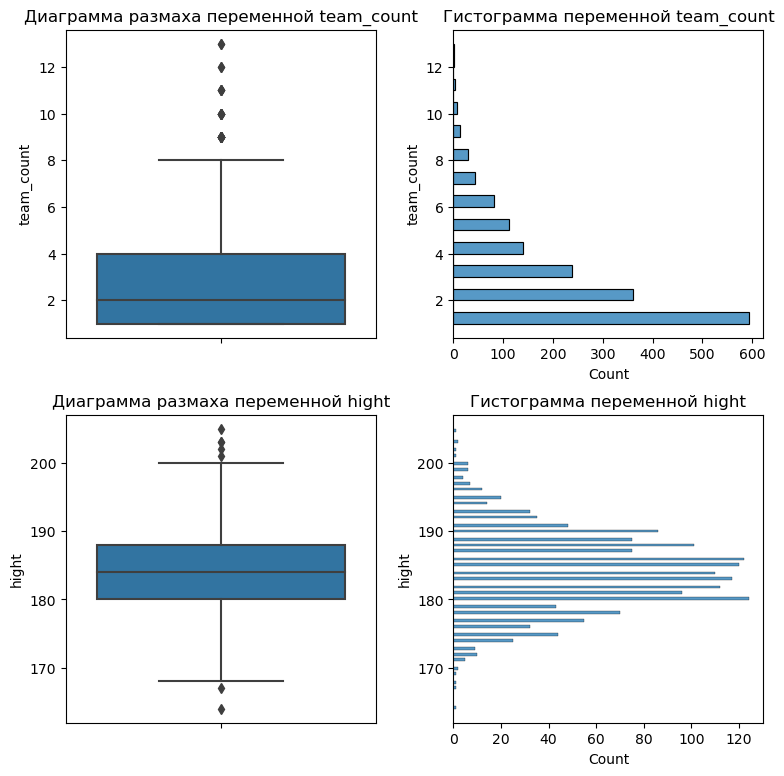

In [31]:
fig = plt.figure(figsize=(9, 9))
fig.subplots_adjust(hspace = 0.25, wspace = 0.25)
ax = fig.add_subplot(2, 2, 1)
ax = sns.boxplot(y=trw['team_count'])
ax.set(title='Диаграмма размаха переменной team_count')
ax1 = fig.add_subplot(2, 2, 2)
ax1 = sns.histplot(y=trw['team_count'])
ax1.set(title='Гистограмма переменной team_count')
ax2 = fig.add_subplot(2, 2, 3)
ax2 = sns.boxplot(y=trw['hight'])
ax2.set(title='Диаграмма размаха переменной hight')
ax3 = fig.add_subplot(2, 2, 4)
ax3 = sns.histplot(y=trw['hight'], bins=100)
ax3.set(title='Гистограмма переменной hight')
plt.show()

Распределение переменной `team_count` имеет положительную скошенность, а диаграмма размаха отражает небольшое количество выбросов. Распределение переменной `hight` похоже на нормальное и также имеется несколько выбросов. Учитывая положительную скошенность переменой `team_count`, а также наличие выбросов для рассчета корелляции целесообразно использовать менее чуствительный к выбросам и независящий от вида распределения переменной коэффициент ранговой корреляции Спирмена. Но для сравнения мы посчитаем как коэффициент корреляции Пирсона, так и коэффициент корреляции Спирмена.

Для того, чтобы наглядно отразить наличие/отсутствие связи между переменными `team_count` и `hight` построим диаграмму рассеяния.

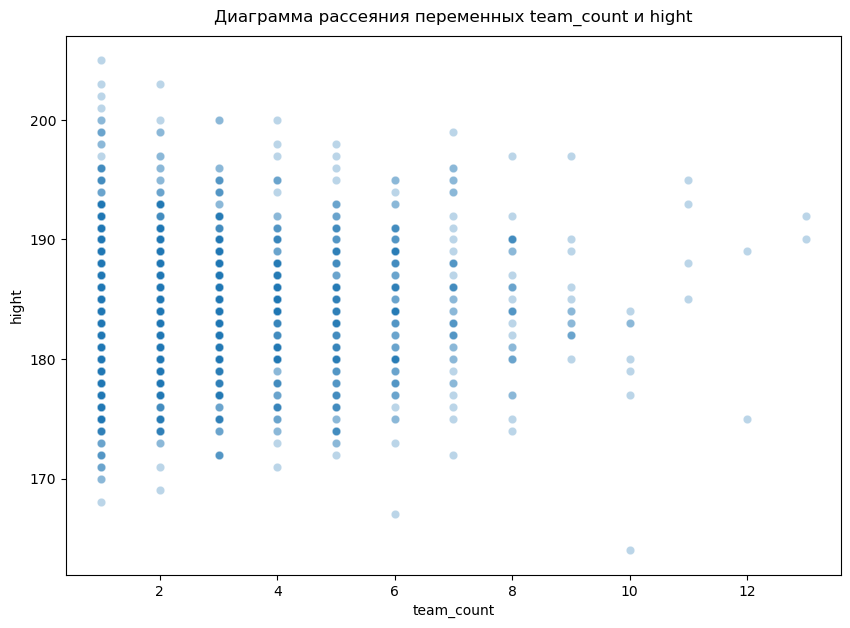

In [32]:
fig, ax = plt.subplots(figsize=(10, 7))
sns.scatterplot(data=trw, x='team_count', y='hight', alpha=.3)
plt.title('Диаграмма рассеяния переменных team_count и hight', pad=10)
plt.show()

Диаграмма показывает отсутствие связи между переходами и ростом игроков. Проверим наше предположение рассчитав коэффициенты корреляции.

Расчитаем коэффициент корреляции Пирсона.

In [33]:
print('Коэффициент корреляции Пирсона равен:', round(trw['team_count'].corr(trw['hight']), 3))

Коэффициент корреляции Пирсона равен: 0.014


Расчитаем коэффициент корреляции Спирмена.

In [34]:
print('Коэффициент корреляции Спирмена равен:', round(trw['team_count'].corr(trw['hight'], method='spearman'), 3))

Коэффициент корреляции Спирмена равен: 0.006


Коэффициент корреляции Спирмена немного меньше, чем коэффициент корреляции Пирсона. Тем не менее они оба достаточно малы, чтобы свидетельствоать об отсутствии связи между когличеством переходов и ростом игроков. Предположение о том, что игроки, у которых рост выше, лучше играют в хоккей и соответственно чаще переходят из клуба в клуб не подтвердилось.

Дополнительно проверим гипотезу статистическими методами.

Для этого разделим игроков на две группы: высокие и низкие. Чтобы определить высоких и низких игроков посмотрим на их средний и медианный рост.

In [35]:
print('Средний рост игроков: {0:.1f} см'.format(trw.hight.mean()))
print('Средний рост игроков: {0:.1f} см'.format(trw.hight.median()))

Средний рост игроков: 184.2 см
Средний рост игроков: 184.0 см


Средний и медианный рост не отличаются, поэтому возьмем в качестве разделителя медианный рост (непосредственно медианный рост включим в группу высоких игроков).

In [36]:
tall = trw[trw['hight'] >= trw.hight.median()] #группа высоких игроков
low = trw[trw['hight'] < trw.hight.median()] #группа низких игроков

Сравним среднее количество переходов у игроков двух групп.

In [37]:
print('Среднее количество переходов у высоких игроков: {0:.2f}'.format(tall['team_count'].mean()))
print('Среднее количество переходов у низких игроков:  {0:.2f}'.format(low['team_count'].mean()))

Среднее количество переходов у высоких игроков: 2.79
Среднее количество переходов у низких игроков:  2.68


Количество переходов у высоких и низких игроков не сильно отличается.

Выполним статистическую проверку гипотезы.

**Нулевая гипотеза H0:** у высоких и низких игроков отсутствуют различия между количеством переходов из клуба в клуб.<br>
**Альтернативная гипотеза H1:** высокие игроки чаще переходят из клуба в клуб, чем низкие.<br>
Уровень значимости aplha = 0.05.

In [38]:
alpha = 0.05
result = st.ttest_ind(tall['team_count'], low['team_count'], alternative='greater')
print('p-значение:', result.pvalue)
if result.pvalue < alpha:
    print('По имеющимся данным на уровне значимости {0:.0f}%'\
                  .format(alpha * 100),
            'есть основания отвергнуть нулевую гипотезу об отсутствии различий между количеством переходов из клуба в клуб '
            'у высоких и низких игроков в пользу альтернативной гипотезы о большем количестве переходов из клуба в клуб '
            'у высоких, чем у низких.')
else:
    print('По имеющимся данным на уровне значимости {0:.0f}%'\
                  .format(alpha * 100),
            'нет оснований отвергнуть нулевую гипотезу об отсутствии различий между количеством переходов из клуба в клуб '
            'у высоких и низких игроков в пользу альтернативной гипотезы о большем количестве переходов из клуба в клуб '
            'у высоких, чем у низких.')

p-значение: 0.14659385378266437
По имеющимся данным на уровне значимости 5% нет оснований отвергнуть нулевую гипотезу об отсутствии различий между количеством переходов из клуба в клуб у высоких и низких игроков в пользу альтернативной гипотезы о большем количестве переходов из клуба в клуб у высоких, чем у низких.


Гипотеза о существовании связи между количеством переходов и ростом игрока не подтвердилась.

### Кластеризация игроков.

Для наглядности и упрощения задачи кластеризации возьмем следующие признаки игроков: возраст, рост, вес, количество проведенных игр и число Лемтюгова. Данный выбор признаков обусловлен тем, что они все количественные и не имеют пропусков.

In [39]:
X = khl_stats[['id', 'age', 'hight', 'weight', 'gp']].merge(lemtyugov_number[['id', 'number']], on='id').set_index('id')

Стандартизируем признаки и создадим матрицу связности между объектами для построения дендрограммы.

In [40]:
sc = StandardScaler()
X_sc = sc.fit_transform(X)
linked = linkage(X_sc, method = 'ward')

Построим дендрограмму иерархической кластеризации для игроков для того, чтобы определиться с количеством кластеров.

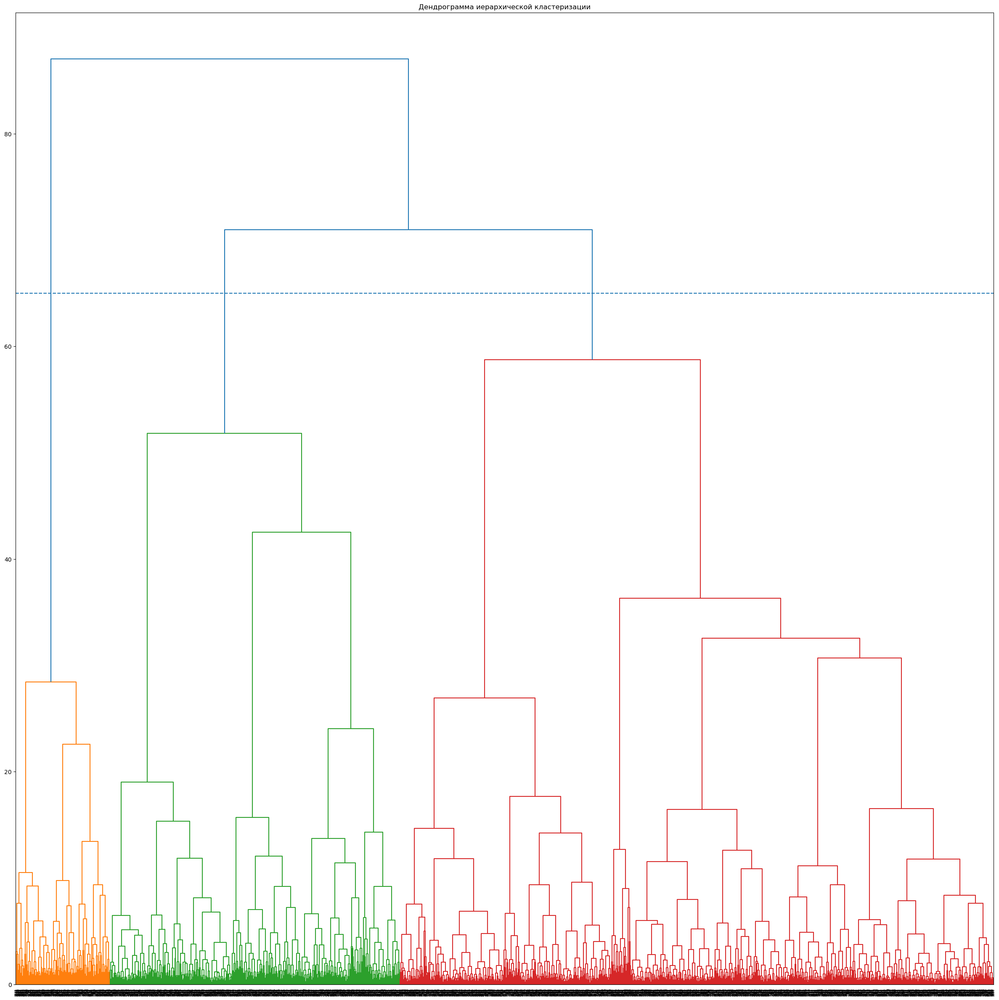

In [41]:
plt.figure(figsize=(30, 30))
dendrogram(linked, orientation='top')
plt.axhline(linestyle='--', y=65)
plt.title('Дендрограмма иерархической кластеризации')
plt.show()

Выделим для игроков КХЛ 3 кластера методом агломеративной иерархической кластеризации.

In [42]:
#обучаем модель
model = AgglomerativeClustering(n_clusters=3, compute_distances=True)
cluster = model.fit(X_sc)

Добавим получившиеся кластеры к нашему датафрейму с признаками.

In [43]:
X['cluster'] = cluster.labels_

In [44]:
X.head()

,age,hight,weight,gp,number,cluster
id,,,,,,
16785,38,184,89,245,1,1
17585,30,177,84,256,2,0
13041,38,178,77,10,2,0
38736,27,185,85,12,2,0
24998,24,187,84,0,2,0


Для того, чтобы попытаться понять по какому приципу произошла кластеризация игроков, построим для признаков попарные диаграммы рассеяния.

In [45]:
#функция отрисовки графиков попарных признаков для кластеров
def show_clusters_on_plot(df, x_name, y_name, cluster_name):
    plt.figure(figsize=(5, 5))
    sns.scatterplot(
        x=df[x_name], y=df[y_name], hue=df[cluster_name], palette='Paired'
    )
    plt.title('{} vs {}'.format(x_name, y_name))
    plt.show()

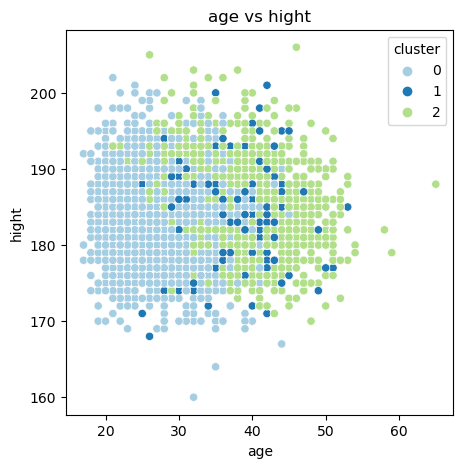

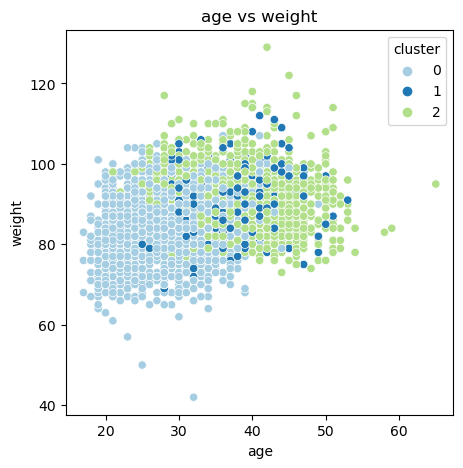

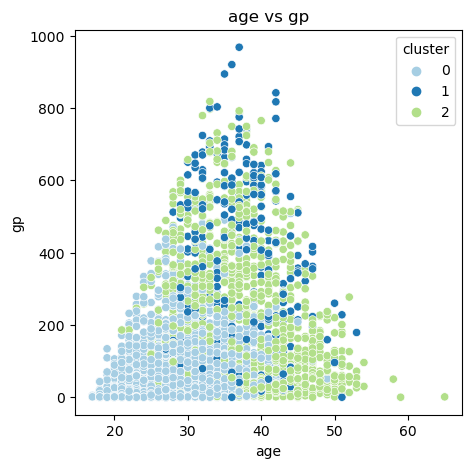

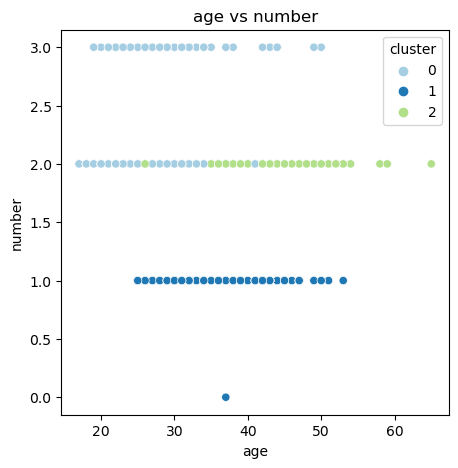

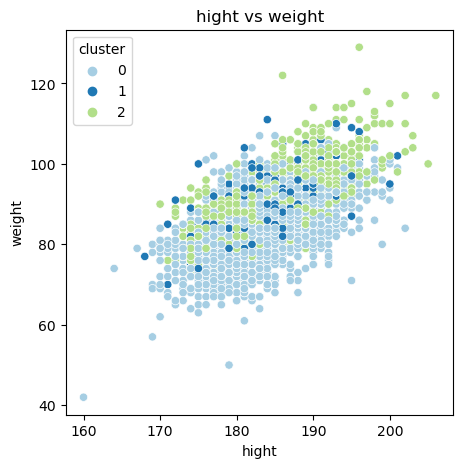

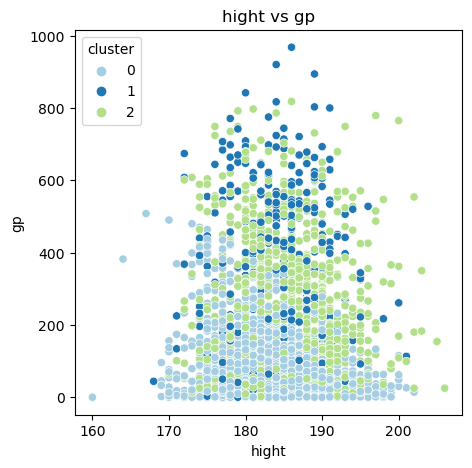

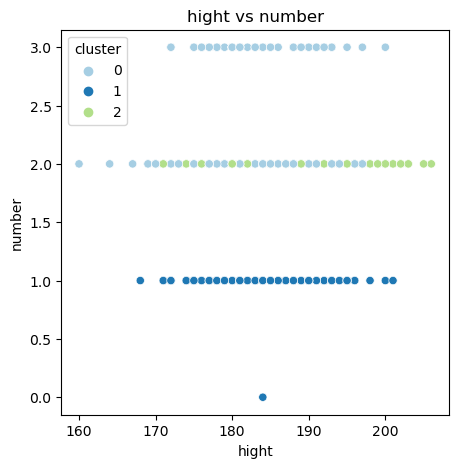

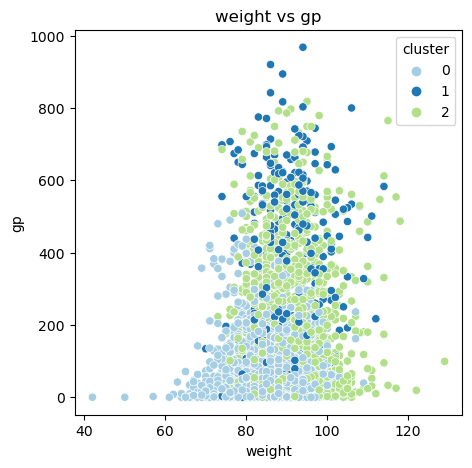

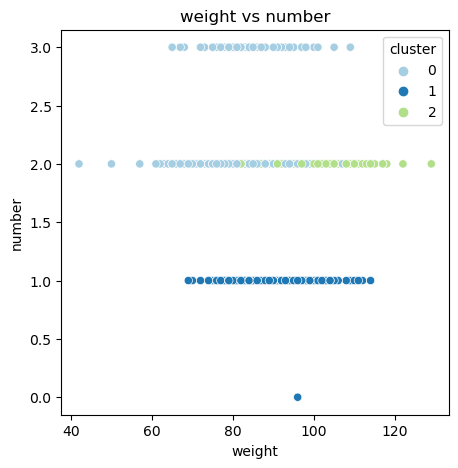

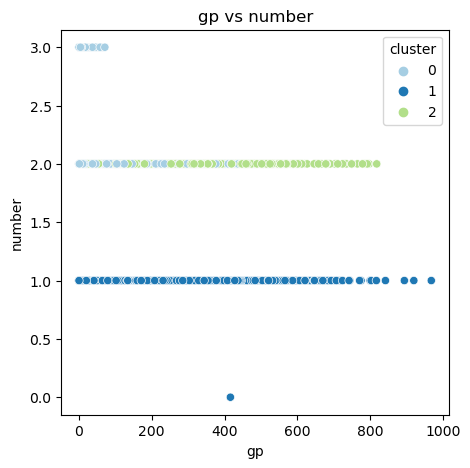

In [46]:
col_pairs = list(itertools.combinations(X.drop('cluster', axis=1).columns, 2))
for pair in col_pairs:
    show_clusters_on_plot(X, pair[0], pair[1], 'cluster')

Ни на одном из графиков не видно явного разделения на кластеры.

По полученным кластерам построим еще одну дендрограмму с количеством объектов в каждом кластере.

In [47]:
#функция для простроения дендрограммы с количеством объектов в каждом кластере
def plot_dendrogram(model, **kwargs):

    #расчет количества объектов в каждом кластере
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    #отрисовка дендрограммы
    dendrogram(linkage_matrix, **kwargs)

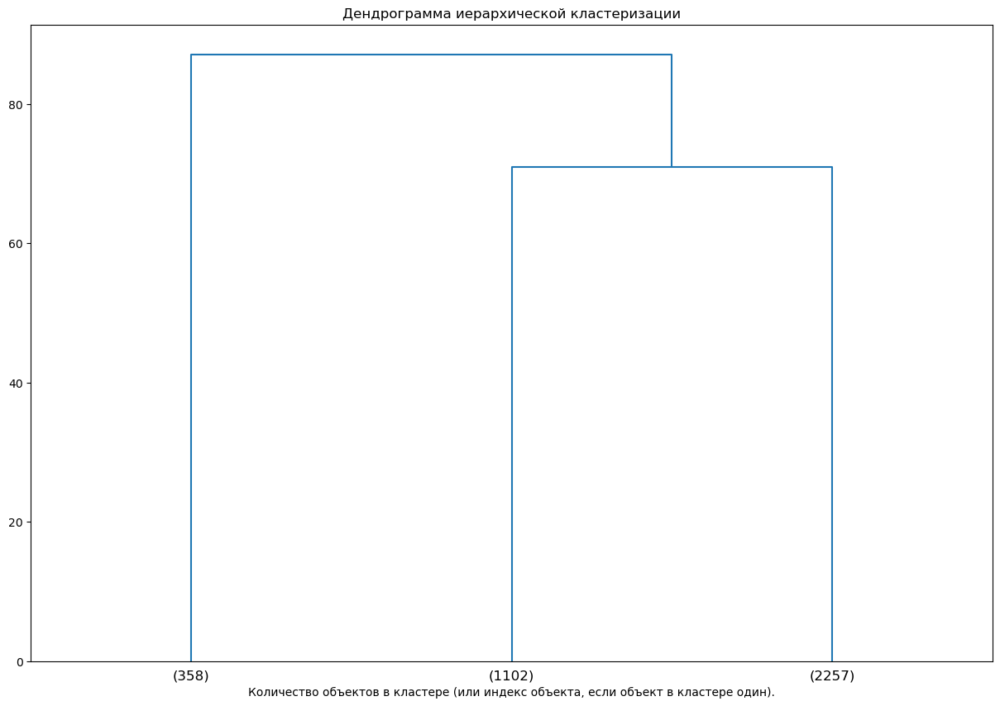

In [48]:
plt.figure(figsize=(15, 10))
plt.title("Дендрограмма иерархической кластеризации")
plot_dendrogram(cluster, truncate_mode="lastp", p=3)
plt.xlabel("Количество объектов в кластере (или индекс объекта, если объект в кластере один).")
plt.show()

Создадим таблицу с количеством игроков в каждом кластере, а также минимальным, максимальным средним и медианным значением для каждого признака.

In [49]:
X.groupby('cluster').agg({'cluster' : 'count', 'age' : ['min', 'max', 'mean', 'median'],\
                          'hight' : ['min', 'max', 'mean', 'median'], 'weight' : ['min', 'max', 'mean', 'median'],\
                          'gp' : ['min', 'max', 'mean', 'median'], 'number' : ['min', 'max', 'mean', 'median']}).round(2)

cluster age                   hight                     weight       \
          count min max   mean median   min  max    mean median    min  max   
cluster                                                                       
0          2257  17  50  28.43   28.0   160  202  183.35  183.0     42  109   
1           358  25  53  36.18   36.0   168  201  184.28  184.0     69  114   
2          1102  21  65  38.92   39.0   170  206  185.16  185.0     73  129   

                       gp                     number                   
          mean median min  max    mean median    min max  mean median  
cluster                                                                
0        84.36   85.0   0  508   61.32   30.0      2   3  2.03    2.0  
1        89.94   90.0   0  968  333.06  333.5      0   1  1.00    1.0  
2        91.21   91.0   0  818  205.13  142.0      2   2  2.00    2.0

In [50]:
X['number'].sort_values().tail()

id
27320    3
39895    3
16546    3
39520    3
42094    3
Name: number, dtype: int64

Из таблицы можно предположить, что:
* в нулевой кластер попали игроки в целом молодые игроки с малым количеством игр и высоким числом Лемтюгова
* в первый кластер попали игроки в целом игроки на пике формы с большим количеством игр и низким числом Лемтюгова
* во второй кластер попали игроки с усредненными показателями первых двух кластеров

Чтобы оценить качество кластеризации рассчитаем метрику Silhouette score.

In [51]:
print('Silhouette_score: {:.2f}'.format(silhouette_score(X_sc, cluster.labels_)))

Silhouette_score: 0.23


Значение метрики довольно невелико, что подтверждается отсутствием четко выраженного разделения кластеров на диаграммах рассеяния.

На этапе проверки гипотез мы узнали:
* гипотеза №1: Николай Лемтюгов – самый популярный хоккеист в лиге, то есть обладающий самым большим количеством одноклубников. Не соответствует действительности. Николай Лемтюгов находится лишь на 50 месте с 357 одноклубниками, а на первом месте - Евгений Лапенков (475 одноклубников).
* гипотеза №2: игроки с низким значением числа Лемтюгова играли в среднем в большем количестве команд, чем игроки, у которых это значение больше. Это действительно так: игроки с числом Лемтюгова равным 1 играли в среднем в 4 командах, с числом равным 2 - в 2 командах и числом равным 3 - в 1 команде.
* гипотеза № 3: существуют ли игроки, у которых отсутствует число Лемтюгова (нет связей через других игроков). Таких игроков не существует.
* гипотеза № 4: существуeт ли связь между количеством переходов и ростом игрока (предполагаем, что игроки, у которых рост выше, лучше играют в хоккей и соответственно чаще переходят из клуба в клуб). Коэффициент корреляции оказался слишком маленьким, чтобы можно было подтвердить связь между количеством переходов и ростом игрока.

Также мы провели кластеризацию игроков методом агломеративной иерархической кластеризации, разделив их на 3 кластера с такими предполагаемыми характеристиками:
* в нулевой кластер попали игроки в целом молодые игроки с малым количеством игр и высоким числом Лемтюгова
* в первый кластер попали игроки в целом игроки на пике формы с большим количеством игр и низким числом Лемтюгова
* во второй кластер попали игроки с усредненными показателями первых двух кластеров

Затем оценили качество кластеризации с помощью метрики Silhouette score, которая оказалась не очень высокой - 0.23.

<a id='5'></a>
## [Визуализация](#7)

### Sankey Chart

Далее идут функции для построения Sankey Chart.

In [52]:
def get_source_index(df, source='from_team'):

    """Функция генерации индексов source

    Args:
        df (pd.DataFrame): исходная таблица с признаками step, source, target.
    Returns:
        dict: словарь с индексами, именами и соответсвиями индексов именам source.
    """

    res_dict = {}

    count = 0
    # получаем индексы источников
    for no, step in enumerate(df['step'].unique().tolist()):
        # получаем уникальные наименования для шага
        res_dict[no+1] = {}
        res_dict[no+1]['sources'] = df[df['step'] == step][source].unique().tolist()
        res_dict[no+1]['players'] = df[df['step'] == step]['player'].unique().tolist()
        res_dict[no+1]['sources_index'] = []
        for i in range(len(res_dict[no+1]['sources'])):
            res_dict[no+1]['sources_index'].append(count)
            count += 1

    # соединим списки
    for key in res_dict:
        res_dict[key]['sources_dict'] = {}
        for name, no in zip(res_dict[key]['sources'], res_dict[key]['sources_index']):
            res_dict[key]['sources_dict'][name] = no
    return res_dict

In [53]:
def generate_random_color():

    """Случайная генерация цветов rgba

    Args:

    Returns:
        str: Строка со сгенерированными параметрами цвета
    """

    # сгенерим значение для каждого канала
    r, g, b = np.random.randint(255, size=3)
    return f'rgba({r}, {g}, {b}, 1)'

In [54]:
def colors_for_sources(mode, df, source='from_team'):

    """Генерация цветов rgba

    Args:
        mode (str): сгенерировать случайные цвета, если 'random', а если 'custom' -
                    использовать заранее подготовленные
    Returns:
        dict: словарь с цветами, соответствующими каждому индексу
    """
    # словарь, в который сложим цвета в соответствии с индексом
    colors_dict = {}

    if mode == 'random':
        # генерим случайные цвета
        for label in df[source].unique():
            r, g, b = np.random.randint(255, size=3)
            colors_dict[label] = f'rgba({r}, {g}, {b}, 1)'

    elif mode == 'custom':
        # присваиваем ранее подготовленные цвета
        colors = requests.get('https://raw.githubusercontent.com/rusantsovsv/senkey_tutorial/main/json/colors_senkey.json').json()
        for no, label in enumerate(df[source].unique()):
            colors_dict[label] = colors['custom_colors'][no]

    return colors_dict

In [55]:
def percent_users(sources, targets, values):

    """
    Расчет уникальных id в процентах (для вывода в hover text каждого узла)

    Args:
        sources (list): список с индексами source.
        targets (list): список с индексами target.
        values (list): список с "объемами" потоков.

    Returns:
        list: список с "объемами" потоков в процентах
    """

    # объединим источники и метки и найдем пары
    zip_lists = list(zip(sources, targets, values))

    new_list = []

    # подготовим список словарь с общим объемом трафика в узлах
    unique_dict = {}

    # проходим по каждому узлу
    for source, target, value in zip_lists:
        if source not in unique_dict:
            # находим все источники и считаем общий трафик
            unique_dict[source] = 0
            for sr, tg, vl in zip_lists:
                if sr == source:
                    unique_dict[source] += vl

    # считаем проценты
    for source, target, value in zip_lists:
        new_list.append(round(100 * value / unique_dict[source], 1))

    return new_list

In [56]:
def lists_for_plot(df, source_indexes, colors, st='step', source='from_team', target='to_team', frac=0):

    """
    Создаем необходимые для отрисовки диаграммы переменные списков и возвращаем
    их в виде словаря

    Args:
        source_indexes (dict): словарь с именами и индексами source.
        colors (dict): словарь с цветами source.
        frac (int): ограничение на минимальный "объем" между узлами.

    Returns:
        dict: словарь со списками, необходимыми для диаграммы.
    """

    sources = []
    targets = []
    values = []
    labels = []
    link_color = []
    link_text = []

    # проходим по каждому шагу
    for step in tqdm(sorted(df['step'].unique()), desc='Шаг'):
        if step + 1 not in source_indexes:
            continue

        # получаем индекс источника
        temp_dict_source = source_indexes[step]['sources_dict']

        # получаем индексы цели
        temp_dict_target = source_indexes[step+1]['sources_dict']

        # проходим по каждой возможной паре, считаем количество таких пар
        for s, index_source in tqdm(temp_dict_source.items()):
            for t, index_target in temp_dict_target.items():
                # делаем срез данных и считаем количество id
                temp_df = df[(df[st] == step)&(df[source] == s)&(df[target] == t)]
                value = len(temp_df)
                # проверяем минимальный объем потока и добавляем нужные данные
                if value > frac:
                    sources.append(index_source)
                    targets.append(index_target)
                    values.append(value)
                    # делаем поток прозрачным для лучшего отображения
                    link_color.append(colors[s].replace(', 1)', ', 0.2)'))

    labels = []
    colors_labels = []
    for key in source_indexes:
        for name in source_indexes[key]['sources']:
            labels.append(name)
            colors_labels.append(colors[name])

    # посчитаем проценты всех потоков
    perc_values = percent_users(sources, targets, values)

    # добавим значения процентов для howertext
    link_text = []
    for perc in perc_values:
        link_text.append(f"{perc}%")

    # возвратим словарь с вложенными списками
    return {'sources': sources,
            'targets': targets,
            'values': values,
            'labels': labels,
            'colors_labels': colors_labels,
            'link_color': link_color,
            'link_text': link_text}

In [57]:
def plot_senkey_diagram(title, data_dict, width=2000, height=1000):

    """
    Функция для генерации объекта диаграммы Сенкей

    Args:
        data_dict (dict): словарь со списками данных для построения.

    Returns:
        plotly.graph_objs._figure.Figure: объект изображения.
    """

    fig = go.Figure(data=[go.Sankey(
        domain = dict(
          x = [0,1],
          y = [0,1]
        ),
        orientation = "h",
        valueformat = ".0f",
        node = dict(
          pad=50,
          thickness=15,
          line=dict(color = "black", width = 0.1),
          label=data_dict['labels'],
          color=data_dict['colors_labels'],
          #customdata=data_dict['players'],
          hovertemplate='Всего переходов у команды %{label}: %{value}<extra></extra>'
        ),
        link = dict(
          arrowlen=15,
          source=data_dict['sources'],
          target=data_dict['targets'],
          value=data_dict['values'],
          label=data_dict['link_text'],
          color=data_dict['link_color'],
          customdata=data_dict['link_text'],
          hovertemplate='Из команды %{source.label}<br />'+
        'в команду %{target.label}<br /> перешло игроков: %{value}'+
        ', что составляет %{customdata}<br />',
      ))])
    fig.update_layout(title_text=title, font_size=10, width=width, height=height)



    # возвращаем объект диаграммы
    return fig

Найдем топ-20 игроков с самым большим количеством переходов между командами.

In [58]:
#отбираем топ-20 id игроков с самым большим количеством переходов
top_tr_id = transfers.groupby(['id', 'player']).agg(team_count=('from_team', 'count'))\
.sort_values(by=['team_count', 'player'], ascending=[False, True]).reset_index()['id'].head(20)

In [59]:
#отбираем топ-20 игроков с самым большим количеством переходов и нумеруем их переходы
top_transfers = transfers.query('id in @top_tr_id').sort_values(by=['player', 'date'])
top_transfers['step'] = top_transfers.groupby('id').cumcount() + 1

In [60]:
top_transfers.head(10)

,id,player,date,from_team,to_team,step
3712,14674,Alexander Lazushin,2010-12-12,Lokomotiv,Metallurg Nk,1
3711,14674,Alexander Lazushin,2013-01-30,Metallurg Nk,OHC Dynamo M,2
3710,14674,Alexander Lazushin,2017-03-16,OHC Dynamo M,Lada,3
3709,14674,Alexander Lazushin,2018-03-01,Lada,Kunlun RS,4
3708,14674,Alexander Lazushin,2019-02-22,Kunlun RS,Lokomotiv,5
3707,14674,Alexander Lazushin,2020-03-11,Lokomotiv,Kunlun RS,6
3706,14674,Alexander Lazushin,2020-09-12,Kunlun RS,Dinamo R,7
3705,14674,Alexander Lazushin,2020-11-07,Dinamo R,Kunlun RS,8
3704,14674,Alexander Lazushin,2021-12-02,Kunlun RS,Admiral,9
5861,12990,Alexander Ryazantsev,2008-09-13,SKA,Avangard,1


In [61]:
#создаем словарь индексов source
source_indexes = get_source_index(top_transfers)

In [62]:
#генерируем цвета из списка
colors_dict = colors_for_sources(mode='random', df=top_transfers)

In [63]:
#создаем нужные данные для построения диаграммы
data_for_plot = lists_for_plot(top_transfers, source_indexes, colors_dict)

100%|██████████| 15/15 [00:00<00:00, 168.50it/s]

100%|██████████| 15/15 [00:00<00:00, 211.22it/s]

100%|██████████| 16/16 [00:00<00:00, 238.75it/s]

100%|██████████| 14/14 [00:00<00:00, 166.63it/s]

100%|██████████| 13/13 [00:00<00:00, 295.39it/s]

100%|██████████| 10/10 [00:00<00:00, 399.91it/s]

100%|██████████| 7/7 [00:00<00:00, 699.85it/s]

Шаг: 100%|██████████| 13/13 [00:00<00:00, 18.65it/s]


Построим Sankey Chart для топ-20 игроков по переходам между командами.

In [64]:
sankey_chart = plot_senkey_diagram('Переходы топ-20 игроков между командами КХЛ', data_for_plot)
sankey_chart.show()

### Визуализация графа связей между игроками

Визуализируем граф топ-50 игроков по количеству одноклубников и их связей.

In [65]:
khl_tm = khl_teammates[['id', 'player', 'id_y', 'player_y']]

In [66]:
top_id = khl_tm.groupby(['id'])['id_y'].nunique().sort_values(ascending=False).head(50).index.to_list()
top_ids = khl_tm.query('id in @top_id')

In [67]:
#Создаем лист для изменения расчета расстояний между элементами.
#Он нам понадобится, если захотим применить метод расчета расстояний shell_layout
tm = top_ids.groupby('player').agg({'player_y': 'unique'})['player_y'].to_dict()
for k, v in tm.items():
    tm[k] = v.tolist()

lst = []
for i, v in zip(top_id, tm.values()):
    lst.append([i])
    lst.append(v)

In [68]:
#Создаем граф из таблицы pandas - у библиотеки Networks два метода работы с датафреймами pandas, разберем from_pandas_edgelist
G = nx.from_pandas_edgelist(top_ids, 'player', 'player_y')
pos = nx.spring_layout(G)

In [69]:
#Добавляем атрибут с информацией по расположению узлов
for node in G.nodes:
    G.nodes[node]['pos'] = list(pos[node])

Строим граф топ-50 игроков и их связей.

In [70]:
kwargs = dict(width=800, height=800, xaxis=None, yaxis=None)
opts.defaults(opts.Nodes(**kwargs), opts.Graph(**kwargs))

colors = ['#000000']+hv.Cycle('Category20').values

graph = hv.Graph.from_networkx(G, pos)

graph.opts(cmap=colors, node_size=5, edge_line_width=1,
              node_line_color='gray', title='Граф топ-50 игроков и их связей', fontsize=16)

show(hv.render(graph))

Строим граф топ-50 игроков и их значимых связей

In [71]:
bundled = bundle_graph(graph)
graph.opts(title='Граф топ-50 игроков и их значимых связей', fontsize=16)
show(hv.render(bundled))

На этапе визуализации мы создали Sankey Chart для отображения переходов топ-20 игроков между командами КХЛ, визуализировали два графа топ-50 игроков по количеству одноклубников со всеми связями между игроками и только со значимыми.

<a id='6'></a>
## [Общий вывод](#7)

#### [Этап ознакомления с данными:](#1)

В датафрейме khl 8179 строк и 5 столбцов, khl_stats - 3717 строк и 50 столбцов. Имеется достаточное количетсво данных для проведения исследования. В датафрейме khl пропущеные значения отстутсвут, нужно привести столбцы с датами к соответствующему формату. В датафрейме khl_stats есть пропущеные значения, большинство которых может быть связано с разными параметрами статистики полевых игроков и вратарей.

#### [Этап предобработки данных:](#2)

Заменили тип столбцов 'start_date', 'end_date' в датафрейме khl на datetime, убедились в отсутствии явных дубликатов в датафреймах, подготовили данные для расчета числа Лемтюгова.

#### [Этап расчета числа Лемтюгова:](#3)

На этапе расчета числа Лемтюгова мы создали граф из id игроков и их одноклубников, а затем с помощью функции для поиска кратчайшего пути между двумя вершинами на графе рассчитали число Лемтюгова для каждого игрока КХЛ. Данное число варьируется от 0 до 3.

#### [Этап проверки гипотез:](#4)

* гипотеза №1: Николай Лемтюгов – самый популярный хоккеист в лиге, то есть обладающий самым большим количеством одноклубников. Не соответствует действительности. Николай Лемтюгов находится лишь на 50 месте с 357 одноклубниками, а на первом месте - Евгений Лапенков (475 одноклубников).
* гипотеза №2: игроки с низким значением числа Лемтюгова играли в среднем в большем количестве команд, чем игроки, у которых это значение больше. Это действительно так: игроки с числом Лемтюгова равным 1 играли в среднем в 4 командах, с числом равным 2 - в 2 командах и числом равным 3 - в 1 команде.
* гипотеза № 3: существуют ли игроки, у которых отсутствует число Лемтюгова (нет связей через других игроков). Таких игроков не существует.
* гипотеза № 4: существуeт ли связь между количеством переходов и ростом игрока (предполагаем, что игроки, у которых рост выше, лучше играют в хоккей и соответственно чаще переходят из клуба в клуб). Коэффициент корреляции оказался слишком маленьким, чтобы можно было подтвердить связь между количеством переходов и ростом игрока.

Также мы провели кластеризацию игроков методом агломеративной иерархической кластеризации, разделив их на 3 кластера с такими предполагаемыми характеристиками:
* в нулевой кластер попали игроки в целом молодые игроки с малым количеством игр и высоким числом Лемтюгова
* в первый кластер попали игроки в целом игроки на пике формы с большим количеством игр и низким числом Лемтюгова
* во второй кластер попали игроки с усредненными показателями первых двух кластеров

Затем оценили качество кластеризации с помощью метрики Silhouette score, которая оказалась не очень высокой - 0.23.

#### [Этап визуализации:](#5)

На этапе визуализации мы создали Sankey Chart для отображения переходов топ-20 игроков между командами КХЛ, визуализировали два графа топ-50 игроков по количеству одноклубников со всеми связями между игроками и только со значимыми.